# Using K-nearest neighbour classification to predict Turkish dry beans.

DSCI 100 Group Project Report

Group 18: Brooklyn Wang, Mahir Patel, Ashmit Ghai, Mark Cao

## Introduction
Dry beans, a part of the diverse legume family, are affordable and nutritious, containing high amounts of fibre, protein, and minerals. In this project, we will be using the Dry Bean dataset from the UCI Machine Learning Repository. It contains high-resolution images of seven types of beans and their sixteen features, composed of twelve dimensions and four distinct shapes. These features are described in the following table:


![features](images/features.png)

The bean types found in the dataset are well-known Turkish varieties, which includes: Seker, Barbunya, Bombay, Cali, Horoz, Sira, and Dermason. Images of each bean can be found in Figure 1 below.

*Figure 1. Images of each bean included in the Dry Bean dataset (Koklu & Ozkan, 2020).*

![beans](images/beans.jpg)

As technological advances progress, machine learning can be used to find patterns or make predictions from data that the model will train on. In our project, we will use K-nearest neighbour (KNN) classification to build a model that will predict the bean’s class based on its features. We will be exploring the following questions: what are the most appropriate physical characteristics of a bean that can be used to predict its type and how accurate is our KNN model at classifying the bean types?

## Methods
### Loading and wrangling data:
We will start by loading necessary libraries into our notebook (descriptions of each library can be found in the comments in the code cell). The original dataset is an Excel file. However, because we want an .ipynb file that is reproducible, reading in the dataset through Excel would require an additional file for the notebook to run. Therefore, we will read in the bean dataset using a web link, created through converting the Excel file into a .csv file uploaded to GitHub, into R. Because we want our analysis to be reproducible, we are going to set the seed, since data analyses often involve randomness; if we do not set the seed, our analysis will not be reproducible.

In [1]:
# load packages
library(tidyverse) # contains various packages to load, clean, wrangle, and visualize data
library(repr) # to adjust height and width of plots
library(tidymodels) # to perform K-nearest neighbour classification
library(GGally) # extension of ggplot2 package - contains ggpairs function to build a scatterplot matrix
library(cowplot) # extension of ggplot 2 package - contains plot_grid to arrange plots into a grid

# set the seed
set.seed(123)

Warning message:
“package ‘ggplot2’ was built under R version 4.3.2”
── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5     ✔ rsample      1.2.0
✔ dials        1.2.0     ✔ tune         1.1.2
✔ infer        1.0.5     ✔ workflows    1.1.3
✔ modeldata    1.2.0     ✔ workflowsets 1.0.1
✔ parsnip      1.1.1     ✔ yardstick    1.2.0
✔ recipes      1.0.8     

── Conflicts ───────────────────────────────────────── tidymodels_co

In [2]:
# load data
bean_data <- read_csv("https://raw.githubusercontent.com/Mark20050713/group_18/main/dry-bean-dataset.csv")
head(bean_data)

Rows: 13611 Columns: 17
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (1): Class
dbl (16): Area, Perimeter, MajorAxisLength, MinorAxisLength, AspectRation, E...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
28395,610.291,208.1781,173.8887,1.197191,0.5498122,28715,190.1411,0.7639225,0.9888560,0.9580271,0.9133578,0.007331506,0.003147289,0.8342224,0.9987239,SEKER
28734,638.018,200.5248,182.7344,1.097356,0.4117853,29172,191.2728,0.7839681,0.9849856,0.8870336,0.9538608,0.006978659,0.003563624,0.9098505,0.9984303,SEKER
29380,624.110,212.8261,175.9311,1.209713,0.5627273,29690,193.4109,0.7781132,0.9895588,0.9478495,0.9087742,0.007243912,0.003047733,0.8258706,0.9990661,SEKER
30008,645.884,210.5580,182.5165,1.153638,0.4986160,30724,195.4671,0.7826813,0.9766957,0.9039364,0.9283288,0.007016729,0.003214562,0.8617944,0.9941988,SEKER
30140,620.134,201.8479,190.2793,1.060798,0.3336797,30417,195.8965,0.7730980,0.9908932,0.9848771,0.9705155,0.006697010,0.003664972,0.9419004,0.9991661,SEKER
30279,634.927,212.5606,181.5102,1.171067,0.5204007,30600,196.3477,0.7756885,0.9895098,0.9438518,0.9237260,0.007020065,0.003152779,0.8532696,0.9992358,SEKER


*Table 2. Dry Bean dataset from UCI Machine Learning Repository (Dry Bean, 2020).*

As we can see in Table 2, our dataset has all the requirements to be called a tidy dataset: each row is a single observation, each column is a single variable, and each cell contains only one value. We have 17 columns in total in the dataframe: 16 are of the double data type (these are our morphological and shape-based features of the beans) and the last column is the type of bean (Class) as a character data type. However, because we are going to be using K-nearest neighbour classification in this project, we want the bean type column (Class) to be a factor, instead of characters, since there are only 7 categories possible (ie. the 7 bean types used in this dataset).

In [3]:
bean_data_tidy <- mutate(bean_data, Class = as_factor(Class))
head(bean_data_tidy)

Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
28395,610.291,208.1781,173.8887,1.197191,0.5498122,28715,190.1411,0.7639225,0.9888560,0.9580271,0.9133578,0.007331506,0.003147289,0.8342224,0.9987239,SEKER
28734,638.018,200.5248,182.7344,1.097356,0.4117853,29172,191.2728,0.7839681,0.9849856,0.8870336,0.9538608,0.006978659,0.003563624,0.9098505,0.9984303,SEKER
29380,624.110,212.8261,175.9311,1.209713,0.5627273,29690,193.4109,0.7781132,0.9895588,0.9478495,0.9087742,0.007243912,0.003047733,0.8258706,0.9990661,SEKER
30008,645.884,210.5580,182.5165,1.153638,0.4986160,30724,195.4671,0.7826813,0.9766957,0.9039364,0.9283288,0.007016729,0.003214562,0.8617944,0.9941988,SEKER
30140,620.134,201.8479,190.2793,1.060798,0.3336797,30417,195.8965,0.7730980,0.9908932,0.9848771,0.9705155,0.006697010,0.003664972,0.9419004,0.9991661,SEKER
30279,634.927,212.5606,181.5102,1.171067,0.5204007,30600,196.3477,0.7756885,0.9895098,0.9438518,0.9237260,0.007020065,0.003152779,0.8532696,0.9992358,SEKER


*Table 3. Wrangled and cleaned Dry Bean dataset.*

### Preliminary exploratory data analysis:
Because we are building a classifier in this project, we need to split our dataset into training and testing sets so that we will have data to train our classifier and then another set of data to test our model and evaluate its accuracy. We will be using 75% of the original dataset for training and 25% for testing to maintain a balance between having an accurate model and getting an accurate evaluation of its performance.

In [4]:
# split the dataset into training and testing sets
bean_split <- initial_split(bean_data_tidy, prop = 0.75, strata = Class)

bean_train <- training(bean_split)
bean_test <- testing(bean_split)

Using only our training data, we will now summarize our bean dataset to create a table reporting the number of observations there are in each class. We also are going to create a table that contains the number of rows that are missing data, if any.

In [5]:
# count the number of observations missing data
missing_data_summary <- bean_train |>
    filter(is.na(Area),
           is.na(Perimeter),
           is.na(MajorAxisLength),
           is.na(MinorAxisLength),
           is.na(AspectRation),
           is.na(Eccentricity),
           is.na(ConvexArea),
           is.na(EquivDiameter),
           is.na(Extent),
           is.na(Solidity),
           is.na(Roundness),
           is.na(Compactness),
           is.na(ShapeFactor1),
           is.na(ShapeFactor2),
           is.na(ShapeFactor3),
           is.na(ShapeFactor4)) |>
    summarize(num_rows = n())

missing_data_summary

num_rows
<int>
0


*Table 4. Describes the total number of observation rows missing data.*

In [6]:
# count the number of observations in each class
bean_summary <- bean_train |>
    group_by(Class) |>
    summarize(observations = n())

bean_summary

Class,observations
<fct>,<int>
SEKER,1518
BARBUNYA,984
BOMBAY,399
CALI,1214
HOROZ,1449
SIRA,1982
DERMASON,2659


*Table 5. A summary of the number of observations in each bean type class.*

From Table 4, we can see that there are no observations with missing data in the training set! From Table 5, we can see that the bean with the least number of observations in the training dataset is Bombay (n = 399) and the bean with the most observations is Dermason (n = 2659). Although the number of observations for each bean type is not proportional to each other, if we were to use a large number of neighbours, our classifier would underfit the data. Therefore, even though the smallest number of observations for one bean type is 399, our K value will not be that large so we do not need to worry about the data being imbalanced. 

We will now visualize the training data by creating individual plots for each numerical variable to visualize the spread for each class. First, we will rename the bean classes so that the x-axes are not overcrowded with characters because the plots are small. Because generating several plots with about 10,000 observations causes the kernel to crash, we will randomly create a smaller sample training dataset containing 1000 observations.

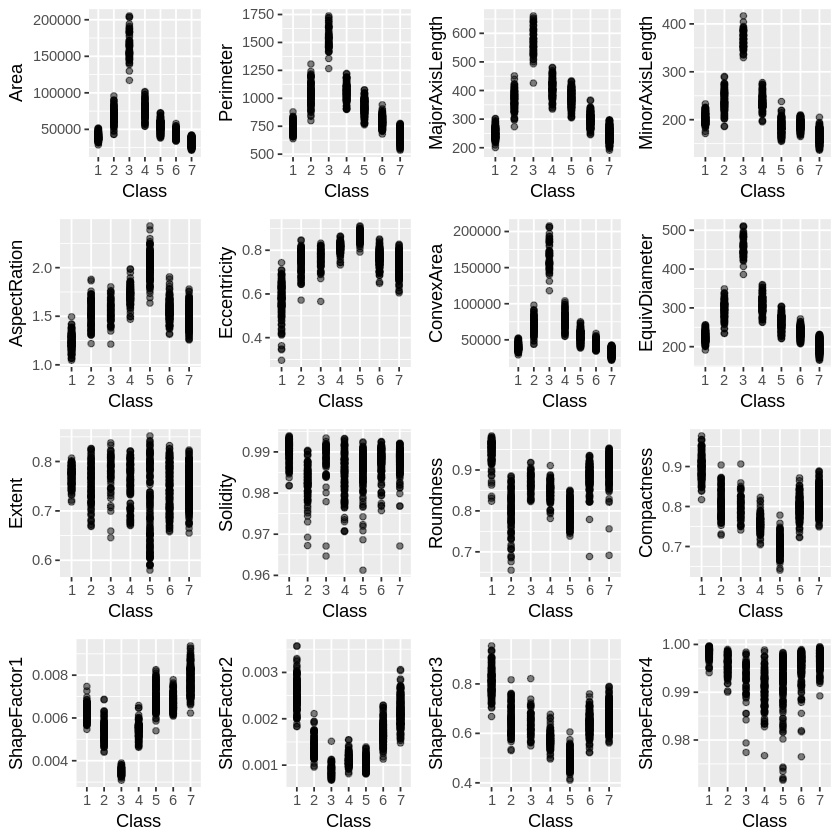

In [7]:
# create a smaller training set for visualization purposes
sample_bean_train <- rep_sample_n(bean_train, size=1000) |>
    ungroup() |>
    select(-replicate)

# rename bean classes
smaller_bean_train <- sample_bean_train |>
    mutate(Class = Class |>
           factor() |>
           fct_recode("1" = "SEKER",
                      "2" = "BARBUNYA",
                      "3" = "BOMBAY",
                      "4" = "CALI",
                      "5" = "HOROZ",
                      "6" = "SIRA",
                      "7" = "DERMASON"))

# create scatterplots that show the spread of each morphological or shape-based characteristic for each bean type
plot_1 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Area)) + geom_point(alpha=0.5)
plot_2 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Perimeter))+ geom_point(alpha=0.5)
plot_3 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = MajorAxisLength))+ geom_point(alpha=0.5)
plot_4 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = MinorAxisLength)) + geom_point(alpha=0.5)
plot_5 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = AspectRation)) + geom_point(alpha=0.5)
plot_6 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Eccentricity)) + geom_point(alpha=0.5)
plot_7 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = ConvexArea)) + geom_point(alpha=0.5)
plot_8 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = EquivDiameter)) + geom_point(alpha=0.5)
plot_9 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Extent)) + geom_point(alpha=0.5)
plot_10 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Solidity)) + geom_point(alpha=0.5)
plot_11 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Roundness)) + geom_point(alpha=0.5)
plot_12 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = Compactness)) + geom_point(alpha=0.5)
plot_13 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = ShapeFactor1)) + geom_point(alpha=0.5)
plot_14 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = ShapeFactor2)) + geom_point(alpha=0.5)
plot_15 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = ShapeFactor3)) + geom_point(alpha=0.5)
plot_16 <- smaller_bean_train |>
    ggplot(aes(x = Class, y = ShapeFactor4)) + geom_point(alpha=0.5)

all_plots <- plot_grid(plot_1, plot_2, plot_3, plot_4, plot_5, plot_6, plot_7, plot_8, plot_9,
                       plot_10, plot_11, plot_12, plot_13, plot_14, plot_15, plot_16,
                       nrow = 4, ncol = 4)
all_plots

*Figure 2. A collection of plots that graph the spreads of the bean properties for each bean class.*

In Figure 2, we can see that some features have relatively similar ranges when comparing between each dry bean type (ex. Eccentricity, Extent, Solidity, and ShapeFactor4). According to a journal, ShapeFactor1, ShapeFactor2, MinorAxisLength, EquivDiameter, Roundness, and ConvexArea are the most important features to use when determining the bean types (Khan et al., 2023).

To choose which two features we want to use as predictors for our classifier, we are going to use ggpairs to visualize the distribution of each feature and the scatterplots that compare two features, coloured based on the bean type class.

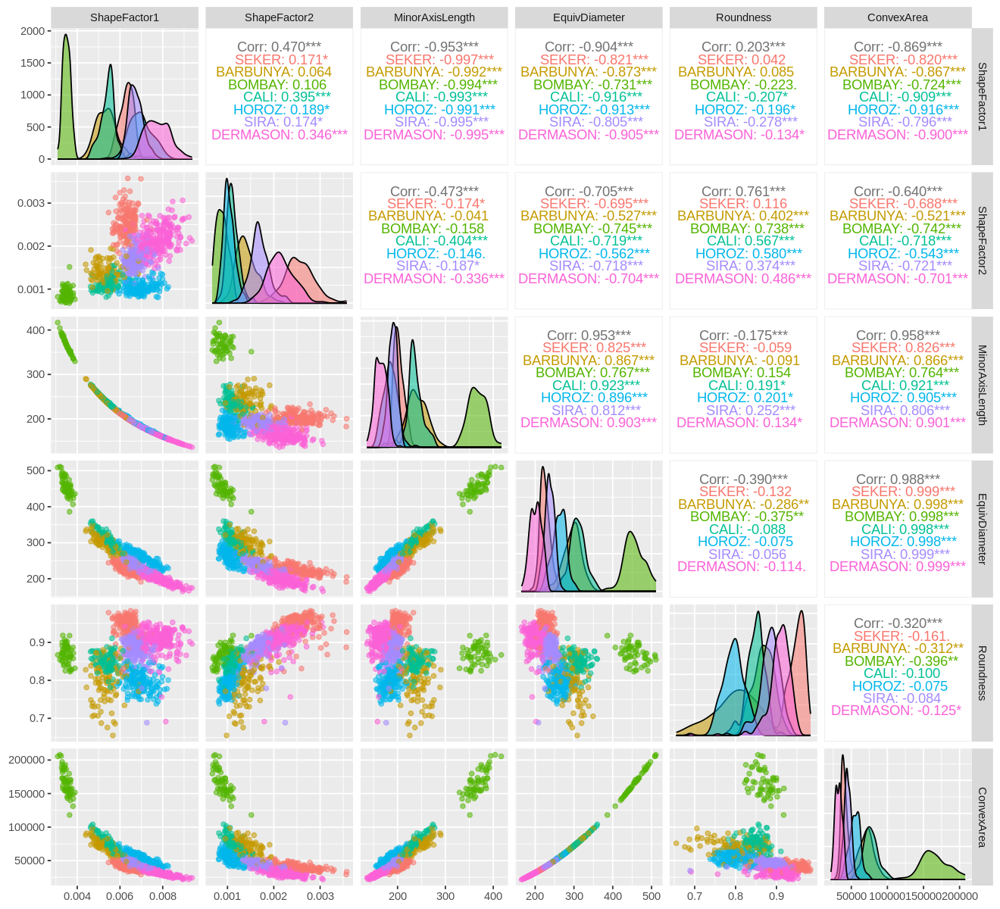

In [8]:
options(repr.plot.width = 11, repr.plot.height = 10)
bean_pairs <- sample_bean_train |>
    select(ShapeFactor1, ShapeFactor2, MinorAxisLength, EquivDiameter, Roundness, ConvexArea) |>
    ggpairs(aes(color = sample_bean_train$Class, alpha = 0.05))

bean_pairs

*Figure 3. GGpairs visualization of various features of the beans, coloured by the bean class. Includes correlation values, distributions, and scatterplots between two features.*

Based on Figure 3, we believe that for a two-predictor classifier, using ShapeFactor1 and ShapeFactor2 as predictors might be the best because the points seem to have their own distinct coloured clusters. The other features' scatterplots do not have as distinct clusters.

## Building the classifier:
We will now build our classification model. First, we must find the optimal K number of nearest neighbours to build our classifier. We are going to perform 5-fold cross-validation because a larger number of folds will take a really long time to run. We will evaluate the estimated accuracies of classifier models with K-values between 1 and 51, stepping by 5 to determine which number of neighbours is best to use for our classifier.

When making our recipe for the classifier, we will use the training data set and will also standardize the predictors. Standardizing the data is important because KNN classification uses the straight-line distance between points to decide which points are the K-nearest to the new observation. Therefore, the scale (size and range) of each variable matters because variables with a large scale will have a larger effect on the classification of an observation compared to variables with smaller scales. In our case, both ShapeFactor1 and ShapeFactor2 have different scales (ShapeFactor1 has a larger scale than ShapeFactor2) so we will standardize the data by centering and scaling the predictors in our recipe.

In [9]:
bean_recipe <- recipe(Class ~ ShapeFactor1 + ShapeFactor2, data = bean_train) |>
    step_scale(all_predictors()) |>
    step_center(all_predictors())
 
knn_spec_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

bean_vfolds <- vfold_cv(bean_train, v = 5, strata = Class)

k_vals <- tibble(neighbors = seq(from = 1, to = 51, by = 5))

In [10]:
knn_results <- workflow() |>
    add_recipe(bean_recipe) |>
    add_model(knn_spec_tune) |>
    tune_grid(resamples = bean_vfolds, grid = k_vals) |>
    collect_metrics()

accuracies <- knn_results |>
    filter(.metric == "accuracy")

accuracies

neighbors,.metric,.estimator,mean,n,std_err,.config
<dbl>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
1,accuracy,multiclass,0.8362540,5,0.002990625,Preprocessor1_Model01
6,accuracy,multiclass,0.8733962,5,0.002382098,Preprocessor1_Model02
11,accuracy,multiclass,0.8796669,5,0.002484561,Preprocessor1_Model03
16,accuracy,multiclass,0.8820169,5,0.003017361,Preprocessor1_Model04
21,accuracy,multiclass,0.8848583,5,0.002680906,Preprocessor1_Model05
26,accuracy,multiclass,0.8862311,5,0.002313238,Preprocessor1_Model06
31,accuracy,multiclass,0.8849572,5,0.002468226,Preprocessor1_Model07
36,accuracy,multiclass,0.8863297,5,0.002089545,Preprocessor1_Model08
41,accuracy,multiclass,0.8855465,5,0.002078370,Preprocessor1_Model09


*Table 6. A summary of the metrics for various test K number of neighbours.*

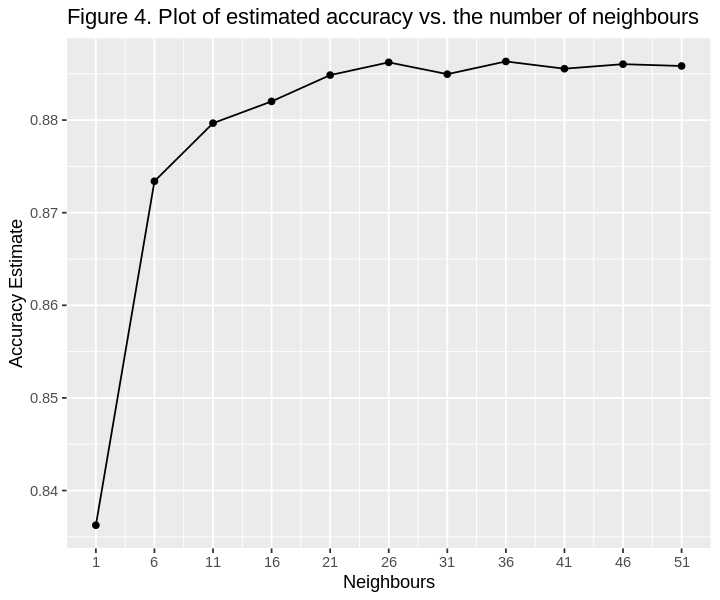

In [11]:
options(repr.plot.width = 6, repr.plot.height = 5)
cross_val_plot <- accuracies |>
    ggplot(aes(x = neighbors, y = mean)) +
    geom_point() +
    geom_line() +
    labs(x = "Neighbours", y = "Accuracy Estimate") +
    scale_x_continuous(breaks = seq(from = 1, to = 51, by = 5)) +
    ggtitle("Figure 4. Plot of estimated accuracy vs. the number of neighbours")

cross_val_plot

In [12]:
# find k with highest estimated accuracy
best_k <- accuracies |>
    arrange(desc(mean))|>
    slice(1)|>
    select(neighbors)|>
    pull()

best_k

[1] 36

We have found that the number of neighbours with the highest estimated accuracy is K = 36. However, looking at Figure 4, it seems that any selection of K from K = 31 to K = 51 is reasonable because the difference between the estimated accuracies in this range of K-values is so little. Just because K = 36 yields the highest estimated accuracy doesn't mean that the classifier will be the most accurate. For our classifier, we will choose K = 36 because the estimated accuracy only changes by a little bit for the other K-values around K = 36. As well, K = 36 isn't too computationally expensive because it is not a very large number.

# Results
## Evaluating the classifier on the test set:

We will now use our old recipe but create a new model specification using K = 36 neighbours to create a new workflow, fit to the training set, that we can use to evaluate our classifier's accuracy on the test set!

In [13]:
knn_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = best_k) |>
    set_engine("kknn") |>
    set_mode("classification")

knn_fit <- workflow() |>
    add_recipe(bean_recipe) |>
    add_model(knn_spec) |>
    fit(data = bean_test)

bean_test_predictions <- predict(knn_fit, bean_test) |>
    bind_cols(bean_test)

bean_test_accuracy <- bean_test_predictions |>
    metrics(truth = Class, estimate = .pred_class) |>
    filter(.metric == "accuracy") |>
    select(.estimate) |>
    pull()

bean_test_accuracy

[1] 0.8899002

We built a classifier with an estimated accuracy of 89%, based on our test set, using ShapeFactor1 and ShapeFactor2 as predictors! To visualize our classifier's decisions, we will create a coloured prediction map. This plot will illustrate the decisions our K-nearest neighbour classifier would make based on the background colour of each area.

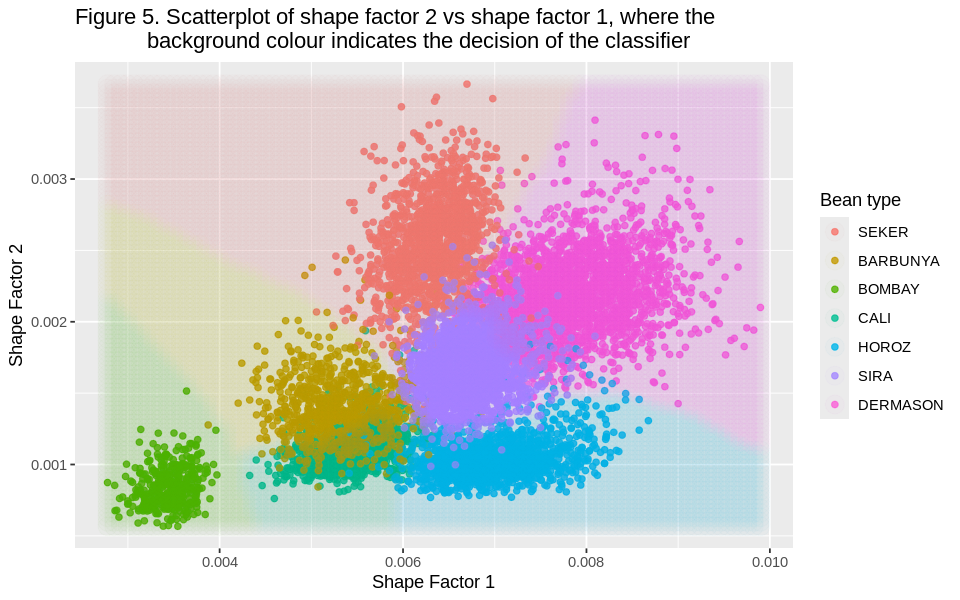

In [14]:
options(repr.plot.width = 8, repr.plot.height = 5)

# create the grid of ShapeFactor1 and ShapeFactor2 values and arrange in a data frame
sf1_grid <- seq(min(bean_train$ShapeFactor1),
                max(bean_train$ShapeFactor1),
                length.out = 100)
sf2_grid <- seq(min(bean_train$ShapeFactor2),
                max(bean_train$ShapeFactor2),
                length.out = 100)
sf_grid <- as_tibble(expand.grid(ShapeFactor1 = sf1_grid,
                                ShapeFactor2 = sf2_grid))

# use fit workflow to make predictions at the grid points
knn_pred_grid <- predict(knn_fit, sf_grid)

# bind predictions as a new column with the grid points
prediction_table <- bind_cols(knn_pred_grid, sf_grid) |>
    rename(Class = .pred_class)

# plot the scatter plot with background colour for the grid points
prediction_plot <- ggplot() +
    geom_point(bean_train,
               mapping = aes(x = ShapeFactor1, y = ShapeFactor2, color = Class),
               alpha = 0.8) +
    geom_point(prediction_table,
               mapping = aes(x = ShapeFactor1, y = ShapeFactor2, color = Class),
               alpha = 0.02,
               size = 5) +
    labs(x = "Shape Factor 1",
         y = "Shape Factor 2",
         color = "Bean type") +
    ggtitle("Figure 5. Scatterplot of shape factor 2 vs shape factor 1, where the
            background colour indicates the decision of the classifier")

prediction_plot

## Discussion
### Summary:
We created a classifier that has an 89% accuracy using ShapeFactor1 and ShapeFactor2 as predictors! Based on our coloured prediction map (Figure 5), we can see that most of the bean types have their own distinct clusters. However, it seems that there are some grey areas where it is difficult to determine which class a bean observation belongs to. We will generate a multiclass confusion matrix to better understand how the test set was classified.

In [15]:
confusion <- bean_test_predictions |>
    conf_mat(truth = Class, estimate = .pred_class)

confusion

          Truth
Prediction SEKER BARBUNYA BOMBAY CALI HOROZ SIRA DERMASON
  SEKER      476        0      0    1     0   10       13
  BARBUNYA     3      238      0   36     0    4        0
  BOMBAY       0        0    123    0     0    0        0
  CALI         0       78      0  369     7    1        0
  HOROZ        0        1      0    7   453    9        3
  SIRA        22       21      0    3    13  563       62
  DERMASON     8        0      0    0     6   67      809

*Table 7. Confusion matrix for the created dry bean classifier*

From Table 7, we can see that there are two pairs of beans that are being classified incorrectly. Barbunya and Cali beans are clustered together and Dermason and Sira beans have a shared boundary. As a result, some Barbunya beans are being classified as Cali beans, and vice versa. This also goes for Dermason and Sira beans. Our classifier is having difficulty accurately determining some of the bean classes because their predictor values are very similar to two types of beans. To improve our classifier, we could maybe investigate if adding more predictors will significantly improve its accuracy.

### Expected outcomes and significance:
We anticipated being able to identify clear relationships between the physical attributes of the beans (in our classifier those attributes were ShapeFactor1 and ShapeFactor2) and their Class representing the bean type. By using past research and our own judgement, we were able to create a classifier that has a relatively high accuracy. For our purposes, an accuracy of 89% is acceptable because our classification of new data is not dependent on getting one class correct to a high degree of recall.

### Future questions:
Having accurate tools available to classify beans based on their physical characteristics could improve agricultural sorting processes, enhance quality control in food production, and contribute to the academic understanding of crop characteristics. It would be interesting to see if incorporating 3D properties of the beans as predictors will improve classifier accuracy. The study of improving machine learning based classification models may open avenues for exploring other physical and perhaps genetic markers for crop classification, leading to advancements in agricultural technology and food science.

## References
Dry Bean. (2020). UCI Machine Learning Repository. https://doi.org/10.24432/C50S4B.

Khan, M. S., Nath, T. D., Hossain, M. M., Mukherjee, A., Hasnath, H. B., Meem, T. M., & Khan, U. (2023). Comparison of multiclass classification techniques using dry bean dataset. International Journal of Cognitive Computing in Engineering, 4, 6–20. https://doi.org/10.1016/j.ijcce.2023.01.002

Koklu, M., & Ozkan, I. A. (2020). Multiclass classification of dry beans using computer vision and Machine Learning Techniques. Computers and Electronics in Agriculture, 174, 105507. https://doi.org/10.1016/j.compag.2020.105507 